In [1]:
import sys
import os

# 将 `code/Ringdown_gap_filling/Proj/` 添加到 sys.path
proj_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
if proj_dir not in sys.path:
    sys.path.append(proj_dir)
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import bilby
import corner
from config.config import Config
from data.waveform import *
from data.ringdown_waveform import Gap_dir as Ga


In [2]:
import os
if not os.path.isfile("toy_model.csv"):
  print("Downloading toy_model.csv")
  ! wget https://raw.githubusercontent.com/gw-odw/odw-2024/main/Tutorials/Day_3/toy_model.csv
else:
  print("toy_model.csv exists; not downloading")

toy_model.csv exists; not downloading


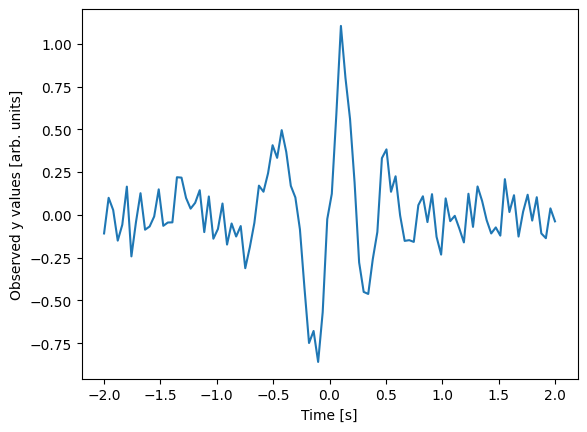

In [3]:
time, yobs = np.genfromtxt("toy_model.csv", delimiter=",").T
fig, ax = plt.subplots()
ax.plot(time, yobs)
ax.set(xlabel="Time [s]", ylabel="Observed y values [arb. units]")
plt.show()

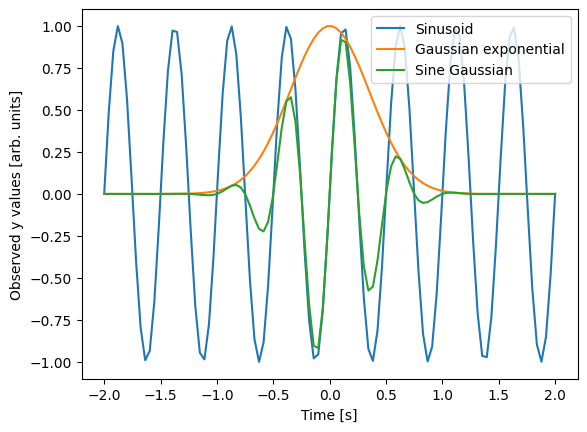

In [4]:
def sinusoid(time, freq):
    return np.sin(2 * np.pi * freq * time)


def gaussian_exponential(time, alpha):
    return np.exp(-(time/alpha)**2)


def model_Ms(time, freq, alpha, **kwargs):
    return gaussian_exponential(time, alpha) * sinusoid(time, freq)

freq = 2
alpha = 0.5

fig, ax = plt.subplots()

ax.plot(time, sinusoid(time, freq), label="Sinusoid")
ax.plot(time, gaussian_exponential(time, alpha), label="Gaussian exponential")
ax.plot(time, model_Ms(time, freq, alpha), label="Sine Gaussian")
ax.set(xlabel="Time [s]", ylabel="Observed y values [arb. units]")
ax.legend()
plt.show()

In [5]:
def model(time,Mtot,M_ratio,R_shift,**kwargs):
    para=[Mtot,M_ratio,R_shift]
    freq_ifft = np.arange(Config.f_in, Config.f_out, Config.f_step)
    sf22, sf21,sf33, sf44 = sf_decomposition(freq_ifft, para, para_dw, para_dtau)
    sf = sf22 + sf21 + sf33 + sf44
    return Ga.Freq_ifft(sf)


In [15]:
Mtot = np.random.uniform(Config.parameters[0], Config.parameters[1])
M_ratio = np.random.uniform(Config.parameters[2], Config.parameters[3])
R_shift = np.random.uniform(Config.parameters[4], Config.parameters[5])
signal_length = Config.signal_length

para1 = [Mtot, M_ratio, R_shift]
freq_ifft = np.arange(Config.f_in, Config.f_out, Config.f_step)
f_sf22, f_sf21,f_sf33, f_sf44 = sf_decomposition(freq_ifft, para1, para_dw, para_dtau)
f_sf = f_sf22 + f_sf21 + f_sf33 + f_sf44
st = np.real(Ga.Freq_ifft(f_sf))

duration = 1 / Config.f_step 



n_points = len(freq_ifft) * 2  


# 时间轴
time = np.linspace(0, duration, n_points, endpoint=False)
yobs=st

In [16]:
print(len(yobs))
print(len(model(time,Mtot,M_ratio,R_shift)))

199998
199998


In [17]:
def log_likelihood_Ms(time, yobs, para, sigma=0.1):
    para = [Mtot, M_ratio, R_shift]
    freq_ifft = np.arange(Config.f_in, Config.f_out, Config.f_step)
    f_sf22, f_sf21,f_sf33, f_sf44 = sf_decomposition(freq_ifft, para, para_dw, para_dtau)
    prediction = f_sf22 + f_sf21 + f_sf33 + f_sf44
    res = yobs - prediction 
    logl = -0.5 * (((res/sigma)**2) + np.log(2 * np.pi * sigma**2))
    # Sum over all log_likelihoods (axis=0)
    return np.sum(logl, axis=0)

In [18]:
def log_prior_Ms(para):
    """ Calculate the log prior under the Ms model
    
    Parameters
    ----------
    freq: array or float
        The frequency at which to calculate the prior
    alpha: array or float
        The alpha at which to calculate the prior
        
    Returns
    -------
    log_prior: array
        The log_prior calculated for all freq, alpha samples
    """
    # Convert freq, alpha to numpy arrays
    Mtot = np.atleast_1d(para[0])
    M_ratio = np.atleast_1d(para[1])
    R_shift=np.atleast_1d(para[2])
    
    # Apply Uniform priors: calculate idxs of array where f, alpha in range
    f_min = 0
    f_max = 5
    f_idxs = (freq > f_min) * (freq < f_max)
    
    alpha_min = 0
    alpha_max = 1
    alpha_idxs = (alpha > alpha_min) * (alpha < alpha_max)
    
    idxs = alpha_idxs * f_idxs
    
    log_prior_volume = np.log(1/(f_max - f_min) * (1 / (alpha_max - alpha_min)))
    
    log_prior = np.zeros_like(freq)
    log_prior[idxs] = log_prior_volume
    log_prior[~idxs] = -np.inf
    return log_prior

In [19]:
# Draw 10000 samples from g(theta)
N = 100000
freq_gsamples = np.random.uniform(1.8, 2.2, N)
alpha_gsamples = np.random.uniform(0.2, 0.6, N)

# Make time a 2D array to enable broadcasting across the samples
time_array = time[:, np.newaxis]
yobs_array = yobs[:, np.newaxis]

# Calculate the log_likelihood and log_prior for all samples
log_likelihood_vals = log_likelihood_Ms(time_array, yobs_array, freq_gsamples, alpha_gsamples)
log_prior_vals = log_prior_Ms(freq_gsamples, alpha_gsamples)
log_posterior_vals = log_likelihood_vals + log_prior_vals

# Calculate the weights
weights = np.exp(log_posterior_vals)

# Normalise the weights
weights = weights / max(weights)

# Rejection sample
keep = weights > np.random.uniform(0, 1, weights.shape)
alpha_samples = alpha_gsamples[keep]
freq_samples = freq_gsamples[keep]

MemoryError: Unable to allocate 298. GiB for an array with shape (199998, 99999) and data type complex128

In [ ]:
mean_f = np.mean(freq_samples)
std_f = np.std(freq_samples)
print(f"We estimate the the mean and standard deviation of frequency to be {mean_f:0.2f}+/-{std_f:0.2f}")

NameError: name 'freq_samples' is not defined

In [ ]:
# To calculate the efficiency
efficiency = len(freq_samples) / len(freq_gsamples)
print(efficiency)

0.02655


In [20]:



likelihood_Ms = bilby.core.likelihood.GaussianLikelihood(time, yobs, model, sigma=0.1)

priors_Ms = dict(
    freq=bilby.core.prior.Uniform(0, 5),
    alpha=bilby.core.prior.Uniform(0, 1)
)

In [1]:
import shutil
import os
output_dir = "custom_model_output_1"
# 强删除输出目录
if os.path.exists(output_dir):
    shutil.rmtree(output_dir)
os.makedirs(output_dir, exist_ok=True)


In [2]:
# 随机生成5个先验点验证似然多样性
for _ in range(5):
    params = priors.sample()
    lnL = custom_likelihood.log_likelihood()
    print(f"Params: {params} → lnL={lnL}")

# 如果输出现类似：
# Params: {'Mtot':111000, 'M_ratio':0.95, ...} → lnL=-231.5
# Params: {'Mtot':115000, 'M_ratio':0.93, ...} → lnL=-240.1 → 正常
# 如果所有lnL相同 → 模型存在严重问题


AttributeError: 'dict' object has no attribute 'sample'

In [1]:
# Example of using bilby.core.likelihood functions
# Define a new likelihood function using bilby.core.likelihood
import sys
import os
import shutil
# 将 `code/Ringdown_gap_filling/Proj/` 添加到 sys.path
proj_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
if proj_dir not in sys.path:
    sys.path.append(proj_dir)
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import bilby
import corner
#from config.config import Config
from data.waveform import *
from data.ringdown_waveform import Gap_dir as Ga
Mtot_mean = 115000
Mtot_std= 5000
def model(time,M,M_ratio,R_shift,**kwargs):
    para=[M*Mtot_std+Mtot_mean,M_ratio,R_shift]
    freq_ifft = np.arange(Config.f_in, Config.f_out, Config.f_step)
    sf22, sf21,sf33, sf44 = sf_decomposition(freq_ifft, para, para_dw, para_dtau)
    sf = sf22 + sf21 + sf33 + sf44
    return Ga.Freq_ifft(sf)[1:1000]
class Config:
    parameters = [1.1e5, 1.2e5, 0.5, 0.7, 4, 6]
    signal_length = 1056
    f_in=1e-5
    f_out=1
    f_step=1e-5
M = np.random.uniform((Config.parameters[0]-Mtot_mean)/Mtot_std, (Config.parameters[1]-Mtot_mean)/Mtot_std)
M_ratio = np.random.uniform(Config.parameters[2], Config.parameters[3])
R_shift = np.random.uniform(Config.parameters[4], Config.parameters[5])
signal_length = Config.signal_length

para1 = [M*Mtot_std+Mtot_mean, M_ratio, R_shift]
freq_ifft = np.arange(Config.f_in, Config.f_out, Config.f_step)
f_sf22, f_sf21,f_sf33, f_sf44 = sf_decomposition(freq_ifft, para1, para_dw, para_dtau)
f_sf = f_sf22 + f_sf21 + f_sf33 + f_sf44
st = np.real(Ga.Freq_ifft(f_sf))

duration = 1 / Config.f_step 



n_points = len(freq_ifft) * 2  


# 时间轴
time = np.linspace(0, duration, n_points, endpoint=False)[1:1000]
yobs=st[1:1000]
import numpy as np
import bilby
from warnings import warn

class CustomLikelihood(bilby.Likelihood):
    def __init__(self, time, yobs, model):
        """
        增强稳定性的自定义似然函数
        
        参数:
            time : array_like
                时间序列数据
            yobs : array_like 
                观测值序列
            model : callable
                模型函数，形式为 model(time, **parameters)
        """
        parameters = dict(Mtot=None, M_ratio=None, R_shift=None)
        super().__init__(parameters=parameters)  # 正确传递字典

        self.time = time
        self.yobs = yobs
        self.model = model
        self.sigma = 1e-15
        self._last_valid_params = None

    def _validate_parameters(self):
        """ 参数物理性验证 """
        params = self.parameters
        conditions = [
            #params['Mtot'] > 0,             # 总质量必须为正
            0 < params['M_ratio'] <= 1,     # 质量比应在(0,1]区间
            params['R_shift'] > 0           # 红移必须为正
        ]
        return all(conditions)

    def _safe_predict(self):
        """ 带防护的模型预测 """
        try:
            # 对参数进行数值稳定处理
            safe_params = {
                'Mtot': max(1e-6, float(self.parameters['Mtot'])),
                'M_ratio': np.clip(self.parameters['M_ratio'], 1e-6, 1.0),
                'R_shift': max(1e-6, float(self.parameters['R_shift']))
            }
            
            prediction = self.model(self.time, **safe_params)
            self._last_valid_params = safe_params.copy()
            return prediction
            
        except (TypeError, ValueError) as e:
            warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
            return self.model(self.time, **self._last_valid_params) if self._last_valid_params else np.zeros_like(self.yobs)

    def log_likelihood(self):
        """
        带数值保护的改进对数似然计算
        """
        # 参数有效性检查
        if not self._validate_parameters():
            return -np.inf

        # 获取模型预测（带保护）
        prediction = self._safe_predict()
        
        # 处理潜在复数结果（即使经过防护）
        residual = np.asarray(self.yobs - prediction).real
        
        # 带数值保护的似然计算
        sigma_sq = max(1e-16, float(self.sigma**2))
        chi_sq = np.sum(np.square(np.divide(residual, self.sigma, 
                                          out=np.zeros_like(residual),
                                          where=abs(self.sigma)>1e-10)))
        
        log_norm = 0.5 * len(self.yobs) * np.log(2 * np.pi * sigma_sq)
        
        log_l = -0.5 * chi_sq - log_norm
        
        # 最终实数强制转换
        return float(np.real_if_close(log_l, tol=1e6))

    # 诊断工具
    def print_diagnostics(self):
        """ 输出当前计算状态的诊断信息 """
        pred = self._safe_predict()
        resid = self.yobs - pred
        print("\n=== 诊断信息 ===")
        print(f"当前参数: {self.parameters}")
        print(f"预测值范围: [{np.min(pred):.3g}, {np.max(pred):.3g}]")
        print(f"残差统计: 均值={np.mean(resid):.3g}, 标准差={np.std(resid):.3g}")
        print(f"最大绝对残差: {np.max(np.abs(resid)):.3g}")


# Example usage
custom_likelihood = CustomLikelihood(time, yobs, model)
# priors = dict(
#     Mtot=bilby.core.prior.Uniform(Config.parameters[0], Config.parameters[1]),
#     M_ratio=bilby.core.prior.Uniform(Config.parameters[2], Config.parameters[3]),
#     R_shift=bilby.core.prior.Uniform(Config.parameters[4], Config.parameters[5])
# )
from bilby.core.prior import PriorDict, Uniform

priors = PriorDict()  # 关键修复：使用 Bilby 的 PriorDict
M_min= (Config.parameters[0]-Mtot_mean)/Mtot_std
M_max= (Config.parameters[1]-Mtot_mean)/Mtot_std
priors["Mtot"] = Uniform(minimum=M_min, maximum=M_max, name="Mtot", latex_label=r"$M_{\rm tot}$")
#priors["Mtot"] = Uniform(minimum=110000, maximum=120000, name="Mtot", latex_label=r"$M_{\rm tot}$")
priors["M_ratio"] = Uniform(minimum=0.9, maximum=1, name="M_ratio", latex_label=r"$q$")
priors["R_shift"] = Uniform(minimum=4, maximum=6, name="R_shift", latex_label=r"$\Delta R$")
print("Priors 类型检查:", type(priors))  # 应输出 <class 'bilby.core.prior.PriorDict'>


# 随机生成5个先验点验证似然多样性
# for _ in range(5):
#     params = priors.sample()
#     lnL = custom_likelihood.log_likelihood()
#     print(f"Params: {params} → lnL={lnL}")

# 如果输出现类似：
# Params: {'Mtot':111000, 'M_ratio':0.95, ...} → lnL=-231.5
# Params: {'Mtot':115000, 'M_ratio':0.93, ...} → lnL=-240.1 → 正常
# 如果所有lnL相同 → 模型存在严重问题


print("Likelihood parameters before sampling:", custom_likelihood.parameters)
print("Priors keys:", priors.keys())
import logging
logging.basicConfig(level=logging.DEBUG)  # 强制输出内部日志

output_dir = "custom_model_output_1"
if os.path.exists(output_dir):
    shutil.rmtree(output_dir)
os.makedirs(output_dir, exist_ok=True)

result = bilby.run_sampler(
    likelihood=custom_likelihood,
    priors=priors,
    sampler="bilby_mcmc",
    nwalkers=24,       # 3参数 → 3*8=24（适中的冗余）
    nsamples=10000,    # 总步数10000（含预烧）
    nburn=3000,        # 预烧3000步 
    a=1.8,             # 控制跳跃幅度以匹配归一化参数
    moves="stretch",   # 对低维问题单一策略足矣
    printdt=60,
    outdir=output_dir,
    label="optimized_mcmc"
)


03:31 bilby INFO    : Running for label 'optimized_mcmc', output will be saved to 'custom_model_output_1'


Priors 类型检查: <class 'bilby.core.prior.dict.PriorDict'>
Likelihood parameters before sampling: {'Mtot': None, 'M_ratio': None, 'R_shift': None}
Priors keys: dict_keys(['Mtot', 'M_ratio', 'R_shift'])


WARNING conda.core.prefix_data:_load_site_packages(368): Problem reading non-conda package record at lib/python3.12/site-packages/nvidia_cusolver_cu12-11.4.5.107.dist-info/RECORD. Please verify that you still need this, and if so, that this is still installed correctly. Reinstalling this package may help.
WARNING conda.core.prefix_data:_load_site_packages(368): Problem reading non-conda package record at lib/python3.12/site-packages/nvidia_cudnn_cu12-8.9.2.26.dist-info/RECORD. Please verify that you still need this, and if so, that this is still installed correctly. Reinstalling this package may help.
03:31 bilby INFO    : Analysis priors:
03:31 bilby INFO    : Mtot=Uniform(minimum=-1.0, maximum=1.0, name='Mtot', latex_label='$M_{\\rm tot}$', unit=None, boundary=None)
03:31 bilby INFO    : M_ratio=Uniform(minimum=0.9, maximum=1, name='M_ratio', latex_label='$q$', unit=None, boundary=None)
03:31 bilby INFO    : R_shift=Uniform(minimum=4, maximum=6, name='R_shift', latex_label='$\\Delta 

2.57e+02|0:01:00|1.00e+02(z1)|t=1|n=130|a=0.38|e=5.1e-01%|2.34ms/ev|maxl=17484.24|ETF=0:46:17


03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:32 

4.78e+02|0:02:00|1.00e+02(z1)|t=1|n=315|a=0.38|e=6.6e-01%|2.72ms/ev|maxl=17484.24|ETF=0:52:41


03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:33 

6.61e+02|0:03:00|1.00e+02(z1)|t=1|n=467|a=0.38|e=7.1e-01%|3.29ms/ev|maxl=17484.24|ETF=1:02:40


03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:34 

8.55e+02|0:04:02|1.00e+02(z1)|t=1|n=629|a=0.38|e=7.4e-01%|3.21ms/ev|maxl=17484.24|ETF=1:00:09


03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:35 

1.10e+03|0:05:02|1.00e+02(z1)|t=1|n=831|a=0.38|e=7.6e-01%|2.47ms/ev|maxl=17484.24|ETF=0:45:21


03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:36 

1.31e+03|0:06:02|1.00e+02(z1)|t=1|n=1007|a=0.38|e=7.7e-01%|2.84ms/ev|maxl=17484.24|ETF=0:51:10


03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:37 

1.55e+03|0:07:03|1.00e+02(z1)|t=1|n=1211|a=0.38|e=7.8e-01%|2.45ms/ev|maxl=17484.24|ETF=0:43:05


03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:38 

1.72e+03|0:08:07|1.00e+02(z1)|t=1|n=1350|a=0.38|e=7.8e-01%|3.89ms/ev|maxl=17484.24|ETF=1:07:20


03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:39 

1.96e+03|0:09:08|1.00e+02(z1)|t=1|n=1553|a=0.38|e=7.9e-01%|2.47ms/ev|maxl=17484.24|ETF=0:41:45


03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:40 

2.17e+03|0:10:14|1.00e+02(z1)|t=1|n=1725|a=0.38|e=7.9e-01%|3.19ms/ev|maxl=17484.24|ETF=0:52:46


03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:42 

2.33e+03|0:11:14|1.00e+02(z1)|t=1|n=1858|a=0.38|e=8.0e-01%|3.79ms/ev|maxl=17484.24|ETF=1:01:41


03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:43 

2.53e+03|0:12:14|1.00e+02(z1)|t=1|n=2025|a=0.38|e=8.0e-01%|2.99ms/ev|maxl=17484.24|ETF=0:47:46


03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:44 

2.77e+03|0:13:14|1.00e+02(z1)|t=1|n=2222|a=0.38|e=8.0e-01%|2.55ms/ev|maxl=17484.24|ETF=0:39:39


03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:45 

2.96e+03|0:14:14|1.00e+02(z1)|t=1|n=2380|a=0.38|e=8.0e-01%|3.16ms/ev|maxl=17484.24|ETF=0:48:10


03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:46 

3.15e+03|0:15:14|1.00e+02(z1)|t=1|n=2541|a=0.38|e=8.1e-01%|3.11ms/ev|maxl=17484.24|ETF=0:46:26


03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:47 

3.36e+03|0:16:14|1.00e+02(z1)|t=1|n=2719|a=0.38|e=8.1e-01%|2.82ms/ev|maxl=17484.24|ETF=0:41:06


03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:48 

3.58e+03|0:17:15|1.00e+02(z1)|t=1|n=2901|a=0.38|e=8.1e-01%|2.75ms/ev|maxl=17484.24|ETF=0:39:00


03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:49 

3.69e+03|0:18:15|1.00e+02(z1)|t=1|n=2994|a=0.38|e=8.1e-01%|5.42ms/ev|maxl=17484.24|ETF=1:15:56


03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:50 

3.90e+03|0:19:17|1.00e+02(z1)|t=1|n=3165|a=0.38|e=8.1e-01%|3.02ms/ev|maxl=17484.24|ETF=0:41:19


03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:51 

4.12e+03|0:20:17|1.00e+02(z1)|t=1|n=3353|a=0.38|e=8.1e-01%|2.68ms/ev|maxl=17484.24|ETF=0:35:40


03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:52 

4.37e+03|0:21:18|1.00e+02(z1)|t=1|n=3557|a=0.38|e=8.1e-01%|2.46ms/ev|maxl=17484.24|ETF=0:31:39


03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:53 

4.61e+03|0:22:18|1.00e+02(z1)|t=1|n=3755|a=0.38|e=8.2e-01%|2.53ms/ev|maxl=17484.24|ETF=0:31:34


03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:54 

4.87e+03|0:23:18|1.00e+02(z1)|t=1|n=3975|a=0.38|e=8.2e-01%|2.27ms/ev|maxl=17484.24|ETF=0:27:24


03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:55 

5.08e+03|0:24:18|1.00e+02(z1)|t=1|n=4145|a=0.38|e=8.2e-01%|2.94ms/ev|maxl=17484.24|ETF=0:34:28


03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:56 

5.25e+03|0:25:18|1.00e+02(z1)|t=1|n=4291|a=0.38|e=8.2e-01%|3.43ms/ev|maxl=17484.24|ETF=0:39:13


03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:57 

5.47e+03|0:26:18|1.00e+02(z1)|t=1|n=4471|a=0.38|e=8.2e-01%|2.80ms/ev|maxl=17484.24|ETF=0:30:56


03:58 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
03:58 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:58 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
03:58 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

5.64e+03|0:27:19|1.00e+02(z1)|t=1|n=5535|a=0.38|e=9.8e-01%|3.56ms/ev|maxl=17484.24|ETF=0:26:30


03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
03:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn

5.78e+03|0:28:21|1.00e+02(z1)|t=1|n=5679|a=0.39|e=9.8e-01%|4.34ms/ev|maxl=17484.24|ETF=0:31:17


04:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWa

5.83e+03|0:29:22|1.00e+02(z1)|t=1|n=5728|a=0.39|e=9.8e-01%|12.35ms/ev|maxl=17484.24|ETF=1:27:56


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

5.88e+03|0:30:22|1.00e+02(z1)|t=1|n=5784|a=0.39|e=9.8e-01%|10.73ms/ev|maxl=17484.24|ETF=1:15:22


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

5.94e+03|0:31:22|1.00e+02(z1)|t=1|n=5838|a=0.39|e=9.8e-01%|11.21ms/ev|maxl=17484.24|ETF=1:17:47


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:03 bilby WARNING

6.00e+03|0:32:23|1.00e+02(z1)|t=1|n=5901|a=0.39|e=9.8e-01%|9.59ms/ev|maxl=17484.24|ETF=1:05:30


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp

6.06e+03|0:33:23|1.00e+02(z1)|t=1|n=5956|a=0.40|e=9.8e-01%|10.92ms/ev|maxl=17484.24|ETF=1:13:37


04:05 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:05 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:05 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:05 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

6.12e+03|0:34:23|1.00e+02(z1)|t=1|n=6017|a=0.40|e=9.8e-01%|9.90ms/ev|maxl=17484.24|ETF=1:05:42


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

6.18e+03|0:35:24|1.00e+02(z1)|t=1|n=6078|a=0.40|e=9.8e-01%|9.89ms/ev|maxl=17484.24|ETF=1:04:37


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

6.24e+03|0:36:24|1.00e+02(z1)|t=1|n=6143|a=0.40|e=9.8e-01%|9.35ms/ev|maxl=17484.24|ETF=1:00:07


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:08 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:08 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:08 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWa

6.31e+03|0:37:25|1.00e+02(z1)|t=1|n=6207|a=0.40|e=9.8e-01%|9.54ms/ev|maxl=17484.24|ETF=1:00:20


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

6.37e+03|0:38:26|1.00e+02(z1)|t=1|n=6268|a=0.40|e=9.8e-01%|9.90ms/ev|maxl=17484.24|ETF=1:01:35


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:10 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:10 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:10 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:10 bilby WARNING : FisherMatrixProposal fail

6.43e+03|0:39:26|1.00e+02(z1)|t=1|n=6326|a=0.41|e=9.8e-01%|10.44ms/ev|maxl=17484.24|ETF=1:03:57


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:1

6.48e+03|0:40:27|1.00e+02(z1)|t=1|n=6381|a=0.41|e=9.8e-01%|11.08ms/ev|maxl=17484.24|ETF=1:06:51


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:12 bilby WARNING

6.54e+03|0:41:27|1.00e+02(z1)|t=1|n=6439|a=0.41|e=9.8e-01%|10.35ms/ev|maxl=17484.24|ETF=1:01:25


04:13 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:13 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:13 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:13 bilby WARNING : FisherMatrixProposal fail

6.59e+03|0:42:27|1.00e+02(z1)|t=1|n=6493|a=0.41|e=9.8e-01%|11.13ms/ev|maxl=17484.24|ETF=1:05:04


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:14 bilby WARNING : FisherMatrixProposal fail

6.65e+03|0:43:28|1.00e+02(z1)|t=1|n=6548|a=0.41|e=9.8e-01%|10.96ms/ev|maxl=17484.24|ETF=1:03:03


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

6.70e+03|0:44:28|1.00e+02(z1)|t=1|n=6604|a=0.41|e=9.9e-01%|10.73ms/ev|maxl=17484.24|ETF=1:00:44


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing

6.76e+03|0:45:29|1.00e+02(z1)|t=1|n=6053|a=0.42|e=9.0e-01%|11.10ms/ev|maxl=17484.24|ETF=1:20:17


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:17 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:17 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

6.81e+03|0:46:30|1.00e+02(z1)|t=1|n=6103|a=0.42|e=9.0e-01%|11.16ms/ev|maxl=17484.24|ETF=1:19:45


04:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

6.87e+03|0:47:31|1.00e+02(z1)|t=1|n=6157|a=0.42|e=9.0e-01%|10.26ms/ev|maxl=17484.24|ETF=1:12:18


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:19 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:19 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:19 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:19 bilby WARNING : FisherMatrixProposal fail

6.93e+03|0:48:31|1.00e+02(z1)|t=1|n=6207|a=0.42|e=9.0e-01%|10.95ms/ev|maxl=17484.24|ETF=1:16:10


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:20 bilby WARNING : FisherMatrixProposal fail

6.98e+03|0:49:32|1.00e+02(z1)|t=1|n=6259|a=0.42|e=9.0e-01%|10.69ms/ev|maxl=17484.24|ETF=1:13:19


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

7.04e+03|0:50:32|1.00e+02(z1)|t=1|n=6309|a=0.42|e=9.0e-01%|10.79ms/ev|maxl=17484.24|ETF=1:13:02


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:2

7.09e+03|0:51:33|1.00e+02(z1)|t=1|n=6356|a=0.42|e=9.0e-01%|11.97ms/ev|maxl=17484.24|ETF=1:19:57


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:23 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:23 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:23 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWa

7.15e+03|0:52:35|1.00e+02(z1)|t=1|n=6408|a=0.42|e=9.0e-01%|10.84ms/ev|maxl=17484.24|ETF=1:11:21


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:24 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:24 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:24 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:24 bilby WARNING : FisherMatrixProposal fail

7.21e+03|0:53:36|1.00e+02(z1)|t=1|n=6460|a=0.43|e=9.0e-01%|10.47ms/ev|maxl=17484.24|ETF=1:07:57


04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn

7.26e+03|0:54:36|1.00e+02(z1)|t=1|n=6510|a=0.43|e=9.0e-01%|10.92ms/ev|maxl=17484.24|ETF=1:09:53


04:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

7.32e+03|0:55:37|1.00e+02(z1)|t=1|n=6560|a=0.43|e=9.0e-01%|11.05ms/ev|maxl=17484.24|ETF=1:09:41


04:27 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:27 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:27 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:27 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:27 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

7.37e+03|0:56:38|1.00e+02(z1)|t=1|n=6610|a=0.43|e=9.0e-01%|11.10ms/ev|maxl=17484.24|ETF=1:08:57


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:28 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:28 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:28 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:28 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:28 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

7.43e+03|0:57:38|1.00e+02(z1)|t=1|n=6659|a=0.43|e=9.0e-01%|11.19ms/ev|maxl=17484.24|ETF=1:08:34


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:29 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:2

7.48e+03|0:58:40|1.00e+02(z1)|t=1|n=6711|a=0.43|e=9.0e-01%|10.86ms/ev|maxl=17484.24|ETF=1:05:27


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:30 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:30 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:30 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:30 bilby WARNING : FisherMatrixProposal fail

7.54e+03|0:59:40|1.00e+02(z1)|t=1|n=6760|a=0.43|e=9.0e-01%|11.15ms/ev|maxl=17484.24|ETF=1:06:14


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:31 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:3

7.59e+03|1:00:41|1.00e+02(z1)|t=1|n=6810|a=0.43|e=9.0e-01%|11.04ms/ev|maxl=17484.24|ETF=1:04:35


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:32 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

7.65e+03|1:01:42|1.00e+02(z1)|t=1|n=6860|a=0.43|e=9.0e-01%|10.98ms/ev|maxl=17484.24|ETF=1:03:11


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:33 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:3

7.70e+03|1:02:42|1.00e+02(z1)|t=1|n=6910|a=0.43|e=9.0e-01%|10.92ms/ev|maxl=17484.24|ETF=1:01:52


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:34 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

7.76e+03|1:03:42|1.00e+02(z1)|t=1|n=6960|a=0.44|e=9.0e-01%|11.02ms/ev|maxl=17484.24|ETF=1:01:25


04:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:35 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

7.82e+03|1:04:44|1.00e+02(z1)|t=1|n=7013|a=0.44|e=9.0e-01%|10.68ms/ev|maxl=17484.24|ETF=0:58:29


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing

7.87e+03|1:05:44|1.00e+02(z1)|t=1|n=7065|a=0.44|e=9.0e-01%|10.53ms/ev|maxl=17484.24|ETF=0:56:40


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:37 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWa

7.93e+03|1:06:45|1.00e+02(z1)|t=1|n=7116|a=0.44|e=9.0e-01%|10.88ms/ev|maxl=17484.24|ETF=0:57:31


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:38 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:38 bilby WARNING : FisherMatrixProposal fail

7.98e+03|1:07:45|1.00e+02(z1)|t=1|n=7167|a=0.44|e=9.0e-01%|10.77ms/ev|maxl=17484.24|ETF=0:55:55


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:39 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:39 bilby WARNING : FisherMatrixProposal fail

8.04e+03|1:08:46|1.00e+02(z1)|t=1|n=7215|a=0.44|e=9.0e-01%|11.48ms/ev|maxl=17484.24|ETF=0:58:35


04:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:40 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

8.09e+03|1:09:47|1.00e+02(z1)|t=1|n=7262|a=0.44|e=9.0e-01%|11.60ms/ev|maxl=17484.24|ETF=0:58:12


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:41 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:41 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:41 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:41 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

8.14e+03|1:10:48|1.00e+02(z1)|t=1|n=7312|a=0.44|e=9.0e-01%|11.13ms/ev|maxl=17484.24|ETF=0:54:51


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:42 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:4

8.20e+03|1:11:48|1.00e+02(z1)|t=1|n=7361|a=0.44|e=9.0e-01%|11.13ms/ev|maxl=17484.24|ETF=0:53:52


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:43 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

8.25e+03|1:12:48|1.00e+02(z1)|t=1|n=7412|a=0.44|e=9.0e-01%|10.77ms/ev|maxl=17484.24|ETF=0:51:05


04:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:44 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWa

8.31e+03|1:13:49|1.00e+02(z1)|t=1|n=7462|a=0.45|e=9.0e-01%|11.05ms/ev|maxl=17484.24|ETF=0:51:24


04:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:45 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_4232

8.36e+03|1:14:50|1.00e+02(z1)|t=1|n=7512|a=0.45|e=9.0e-01%|11.08ms/ev|maxl=17484.24|ETF=0:50:31


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:46 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWa

8.42e+03|1:15:51|1.00e+02(z1)|t=1|n=7564|a=0.45|e=9.0e-01%|10.72ms/ev|maxl=17484.24|ETF=0:47:53


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:47 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp

8.48e+03|1:16:52|1.00e+02(z1)|t=1|n=7616|a=0.45|e=9.0e-01%|10.70ms/ev|maxl=17484.24|ETF=0:46:46


04:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:48 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:48 bilby WARNING : FisherMatrixProposal fail

8.53e+03|1:17:53|1.00e+02(z1)|t=1|n=7667|a=0.45|e=9.0e-01%|10.83ms/ev|maxl=17484.24|ETF=0:46:19


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:49 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: mo

8.59e+03|1:18:53|1.00e+02(z1)|t=1|n=7714|a=0.45|e=9.0e-01%|11.69ms/ev|maxl=17484.24|ETF=0:48:59


04:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:50 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

8.64e+03|1:19:54|1.00e+02(z1)|t=1|n=7765|a=0.45|e=9.0e-01%|10.73ms/ev|maxl=17484.24|ETF=0:43:59


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:51 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

8.70e+03|1:20:54|1.00e+02(z1)|t=1|n=7818|a=0.45|e=9.0e-01%|10.42ms/ev|maxl=17484.24|ETF=0:41:41


04:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:52 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

8.75e+03|1:21:55|1.00e+02(z1)|t=1|n=7867|a=0.45|e=9.0e-01%|11.28ms/ev|maxl=17484.24|ETF=0:44:05


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:53 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWa

8.81e+03|1:22:55|1.00e+02(z1)|t=1|n=7916|a=0.45|e=9.0e-01%|11.18ms/ev|maxl=17484.24|ETF=0:42:43


04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:54 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:54 bilby WARNING : FisherMatrixProposal failed with singula

8.86e+03|1:23:55|1.00e+02(z1)|t=1|n=7967|a=0.45|e=9.0e-01%|10.73ms/ev|maxl=17484.24|ETF=0:40:00


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:55 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

8.92e+03|1:24:56|1.00e+02(z1)|t=1|n=8019|a=0.45|e=9.0e-01%|10.63ms/ev|maxl=17484.24|ETF=0:38:36


04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:56 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn

8.98e+03|1:25:56|1.00e+02(z1)|t=1|n=8070|a=0.46|e=9.0e-01%|10.56ms/ev|maxl=17484.24|ETF=0:37:22


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:57 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

9.03e+03|1:26:57|1.00e+02(z1)|t=1|n=8119|a=0.46|e=9.0e-01%|11.41ms/ev|maxl=17484.24|ETF=0:39:21


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:58 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:5

9.09e+03|1:27:57|1.00e+02(z1)|t=1|n=8169|a=0.46|e=9.0e-01%|10.78ms/ev|maxl=17484.24|ETF=0:36:10


04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:59 bilby WARNING : FisherMatrixProposal failed with singular matrix
04:59 bilby WARNING : FisherMatrixProposal failed with singula

9.14e+03|1:28:57|1.00e+02(z1)|t=1|n=8218|a=0.46|e=9.0e-01%|11.33ms/ev|maxl=17484.24|ETF=0:37:00


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:00 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: mo

9.20e+03|1:29:58|1.00e+02(z1)|t=1|n=8271|a=0.46|e=9.0e-01%|10.24ms/ev|maxl=17484.24|ETF=0:32:28


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:01 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

9.26e+03|1:30:58|1.00e+02(z1)|t=1|n=8324|a=0.46|e=9.0e-01%|10.38ms/ev|maxl=17484.24|ETF=0:31:54


05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:02 bilby WARNING : FisherMatrix

9.31e+03|1:31:58|1.00e+02(z1)|t=1|n=8375|a=0.46|e=9.0e-01%|10.73ms/ev|maxl=17484.24|ETF=0:31:57


05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:03 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:03 bilby WARNING : FisherMatrixProposal failed with singula

9.37e+03|1:32:58|1.00e+02(z1)|t=1|n=8429|a=0.46|e=9.0e-01%|10.25ms/ev|maxl=17484.24|ETF=0:29:31


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:04 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:04 bilby WARNING

9.42e+03|1:33:59|1.00e+02(z1)|t=1|n=8477|a=0.46|e=9.0e-01%|11.38ms/ev|maxl=17484.24|ETF=0:31:45


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:05 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp

9.48e+03|1:35:00|1.00e+02(z1)|t=1|n=8529|a=0.46|e=9.0e-01%|10.77ms/ev|maxl=17484.24|ETF=0:29:02


05:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:06 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

9.54e+03|1:36:01|1.00e+02(z1)|t=1|n=8580|a=0.46|e=9.0e-01%|10.87ms/ev|maxl=17484.24|ETF=0:28:17


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:07 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:07 bilby WARNING : FisherMatrixProposal fail

9.59e+03|1:37:02|1.00e+02(z1)|t=1|n=8630|a=0.46|e=9.0e-01%|10.85ms/ev|maxl=17484.24|ETF=0:27:15


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:09 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

9.65e+03|1:38:02|1.00e+02(z1)|t=1|n=8680|a=0.46|e=9.0e-01%|11.05ms/ev|maxl=17484.24|ETF=0:26:44


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:10 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:10 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:10 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWa

9.70e+03|1:39:04|1.00e+02(z1)|t=1|n=8730|a=0.46|e=9.0e-01%|11.11ms/ev|maxl=17484.24|ETF=0:25:51


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:11 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_4232

9.76e+03|1:40:04|1.00e+02(z1)|t=1|n=8784|a=0.46|e=9.0e-01%|10.30ms/ev|maxl=17484.24|ETF=0:22:57


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:12 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWa

9.82e+03|1:41:05|1.00e+02(z1)|t=1|n=8836|a=0.47|e=9.0e-01%|10.66ms/ev|maxl=17484.24|ETF=0:22:45


05:13 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:13 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:13 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:13 bilby WARNING : FisherMatrixProposal fail

9.88e+03|1:42:06|1.00e+02(z1)|t=1|n=8886|a=0.47|e=9.0e-01%|11.02ms/ev|maxl=17484.24|ETF=0:22:30


05:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:14 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

9.93e+03|1:43:07|1.00e+02(z1)|t=1|n=8935|a=0.47|e=9.0e-01%|11.30ms/ev|maxl=17484.24|ETF=0:22:03


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:15 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

9.98e+03|1:44:08|1.00e+02(z1)|t=1|n=8985|a=0.47|e=9.0e-01%|11.19ms/ev|maxl=17484.24|ETF=0:20:48


05:16 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:16 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:16 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:16 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:16 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:16 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:16 bilby WARNING

1.00e+04|1:45:09|1.00e+02(z1)|t=1|n=9037|a=0.47|e=9.0e-01%|10.70ms/ev|maxl=17484.24|ETF=0:18:53


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:17 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp

1.01e+04|1:46:11|1.00e+02(z1)|t=1|n=9089|a=0.47|e=9.0e-01%|10.89ms/ev|maxl=17484.24|ETF=0:18:11


05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:18 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: mo

1.02e+04|1:47:12|1.00e+02(z1)|t=1|n=9137|a=0.47|e=9.0e-01%|11.38ms/ev|maxl=17484.24|ETF=0:18:00


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:19 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:19 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

1.02e+04|1:48:12|1.00e+02(z1)|t=1|n=9188|a=0.47|e=9.0e-01%|10.75ms/ev|maxl=17484.24|ETF=0:16:00


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:20 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required pos

1.03e+04|1:49:13|1.00e+02(z1)|t=1|n=9239|a=0.47|e=9.0e-01%|10.88ms/ev|maxl=17484.24|ETF=0:15:10


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:21 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:2

1.03e+04|1:50:13|1.00e+02(z1)|t=1|n=9293|a=0.47|e=9.0e-01%|10.08ms/ev|maxl=17484.24|ETF=0:13:04


05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:22 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:22 bilby WARNING : FisherMatrixProposal failed with singula

1.04e+04|1:51:14|1.00e+02(z1)|t=1|n=9344|a=0.47|e=9.0e-01%|10.89ms/ev|maxl=17484.24|ETF=0:13:05


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:23 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:23 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效

1.04e+04|1:52:15|1.00e+02(z1)|t=1|n=9395|a=0.47|e=9.0e-01%|10.84ms/ev|maxl=17484.24|ETF=0:12:01


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:24 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp

1.05e+04|1:53:15|1.00e+02(z1)|t=1|n=9447|a=0.47|e=9.0e-01%|10.61ms/ev|maxl=17484.24|ETF=0:10:45


05:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:25 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

1.05e+04|1:54:16|1.00e+02(z1)|t=1|n=9497|a=0.47|e=9.0e-01%|11.07ms/ev|maxl=17484.24|ETF=0:10:12


/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {self._last_valid_params}")
05:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
05:26 bilby WARNING : FisherMatrixProposal failed with singular matrix
/tmp/ipykernel_423281/1188802036.py:104: UserWarning: 参数错误: model() missing 1 required positional argument: 'M'
使用最后有效参数: None
  warn(f"参数错误: {e}\n使用最后有效参数: {sel

1.06e+04|1:55:17|1.00e+02(z1)|t=1|n=10504|a=0.47|e=9.9e-01%|10.65ms/ev|maxl=17484.24|ETF=0


05:27 bilby INFO    : Reached convergence: exiting sampling
05:27 bilby INFO    : Checkpoint start
05:27 bilby INFO    : Written checkpoint file custom_model_output_1/optimized_mcmc_resume.pickle
05:27 bilby INFO    : Zero-temperature proposals:
05:27 bilby INFO    : AdaptiveGaussianProposal(acceptance_ratio:0.23,n:2.1e+05,scale:0.49,)
05:27 bilby INFO    : DifferentialEvolutionProposal(acceptance_ratio:0.4,n:2.2e+05,)
05:27 bilby INFO    : UniformProposal(acceptance_ratio:1,n:1.4e+04,)
05:27 bilby INFO    : KDEProposal(acceptance_ratio:0.31,n:1.8e+05,trained:1,)
05:27 bilby INFO    : FisherMatrixProposal(acceptance_ratio:1,n:2.3e+05,scale:1,)
05:27 bilby INFO    : GMMProposal(acceptance_ratio:0.31,n:2e+05,trained:1,)
05:27 bilby INFO    : Current taus={'Mtot': 1, 'M_ratio': 1.0, 'R_shift': 1.0}
05:27 bilby INFO    : Creating diagnostic plots
INFO:matplotlib.mathtext:Substituting symbol L from STIXNonUnicode
INFO:matplotlib.mathtext:Substituting symbol L from STIXNonUnicode
05:27 bilby

DEBUG:matplotlib.font_manager:findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=16.0.
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/ljq/miniconda3/envs/few_env/lib/python3.12/site-packages/matplotlib/mpl-data/fonts/ttf/cmss10.ttf', name='cmss10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/ljq/miniconda3/envs/few_env/lib/python3.12/site-packages/matplotlib/mpl-data/fonts/ttf/STIXNonUniIta.ttf', name='STIXNonUnicode', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
DEBUG:matplotlib.font_manager:findfont: score(FontEntry(fname='/home/ljq/miniconda3/envs/few_env/lib/python3.12/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSansMono-Oblique.ttf', name='DejaVu Sans Mono', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
DEBUG:m

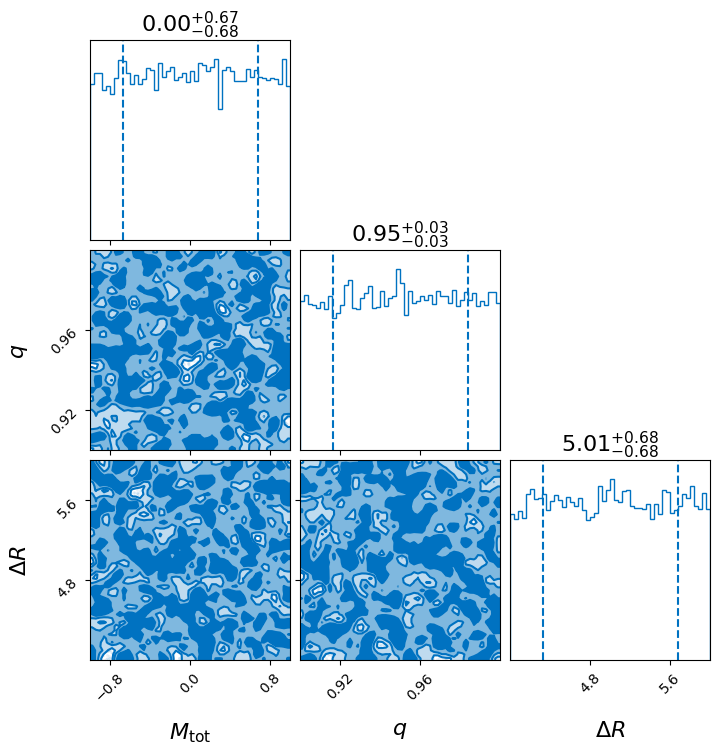

In [2]:
result.plot_corner()

In [ ]:
result.posterior

,freq,alpha,log_likelihood,log_prior
0,1.954845,0.355945,25.758499,-1.609438
1,1.974397,0.354564,25.496148,-1.609438
2,1.974397,0.354564,25.496148,-1.609438
3,1.974397,0.354564,25.496148,-1.609438
4,1.974397,0.354564,25.496148,-1.609438
...,...,...,...,...
2118,1.972849,0.343636,25.651725,-1.609438
2119,1.965173,0.352182,25.735677,-1.609438
2120,1.927958,0.342602,25.897516,-1.609438
2121,1.918939,0.341896,25.785057,-1.609438


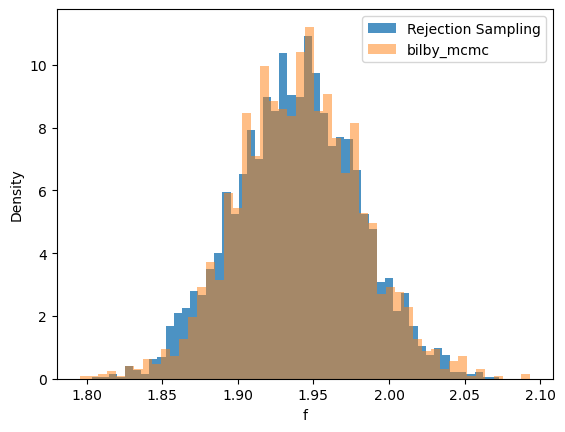

In [ ]:
fig, ax = plt.subplots()
ax.hist(freq_samples, density=True, bins=50, label="Rejection Sampling", alpha=0.8)
ax.hist(result.posterior["freq"], density=True, bins=50, label="bilby_mcmc", alpha=0.5)
ax.set(xlabel="f", ylabel="Density")
plt.legend()
plt.show()

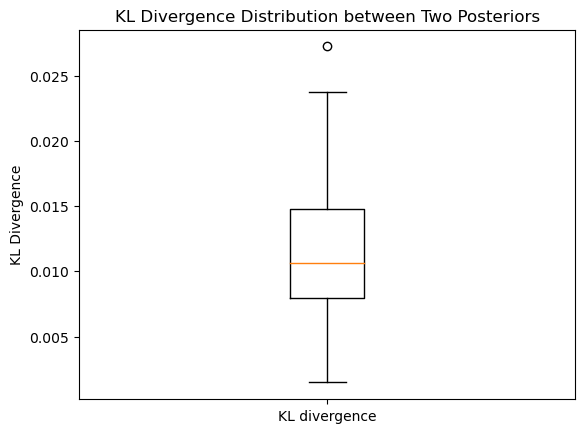

In [ ]:
import numpy as np
from scipy.stats import gaussian_kde, entropy
import matplotlib.pyplot as plt

def compute_kl_divergence(sample1, sample2, num_points=1000):
    """Compute KL divergence between two sets of samples using KDE."""
    kde1 = gaussian_kde(sample1)
    kde2 = gaussian_kde(sample2)
    
    # Define a grid for evaluation
    x_eval = np.linspace(min(min(sample1), min(sample2)), max(max(sample1), max(sample2)), num_points)
    p = kde1(x_eval) + 1e-10  # Avoid zero densities
    q = kde2(x_eval) + 1e-10
    
    # Normalize the densities
    p /= np.sum(p)
    q /= np.sum(q)
    
    # Calculate KL divergence
    return entropy(p, q)

# Generate example posterior samples
np.random.seed(42)
num_trials = 100  # Number of KL divergence computations

kl_values = []
for _ in range(num_trials):
    samples_corrupted = np.random.normal(0, 1, 1000)  # Corrupted posterior samples
    samples_reconstructed = np.random.normal(0.1, 1, 1000)  # Reconstructed posterior samples
    kl_div = compute_kl_divergence(samples_corrupted, samples_reconstructed)
    kl_values.append(kl_div)

# Plot the KL divergence distribution
plt.boxplot(kl_values, labels=["KL divergence"])
plt.ylabel("KL Divergence")
plt.title("KL Divergence Distribution between Two Posteriors")
plt.show()
